Código de matpotlib

In [3]:
from utils.funciones import *

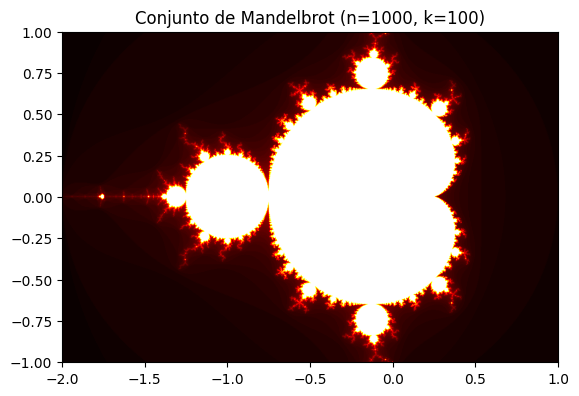

In [4]:
# Ejemplo de uso
plot_mandelbrot(1000, 100, [-2, 1], [-1, 1])


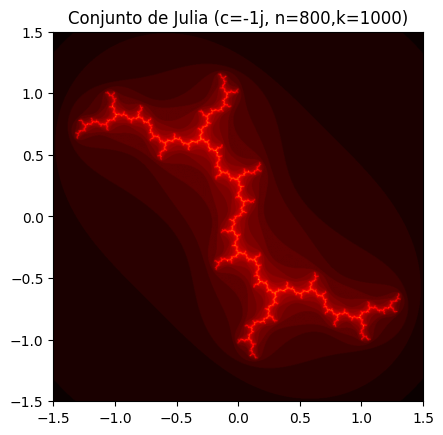

In [5]:
plot_julia(800, 0 - 1j, 1000, [-1.5, 1.5], [-1.5, 1.5])


Codigo de plotly 

In [6]:
# Ejemplo de uso para Mandelbrot_plot
Mandelbrot_plot(1000, 100, [-2, 1], [-1, 1])

In [7]:
# Ejemplo de uso para Julia_plot
Julia_plot(800, 0-0.75j, 100, [-1.5, 1.5], [-1.5, 1.5])

In [8]:

# Ejemplo de uso para Mandelbrot_3D
Mandelbrot_3D(500, 100, [-2, 2], [-2, 2])


Fractal de Koch

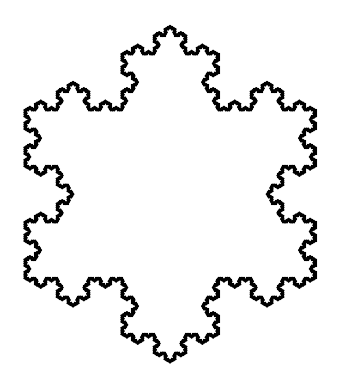

In [9]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation


def koch_curve(ax, x1, y1, x2, y2, iterations):
    """
    Función recursiva para dibujar la curva de Koch.

    Args:
        ax: Axes object para dibujar la curva.
        x1, y1, x2, y2: Coordenadas del segmento de línea inicial.
        iterations: Número de iteraciones para generar la curva.

    Returns:
        None
    """
    if iterations == 0:
        # Caso base: dibujar un segmento de línea recta
        ax.plot([x1, x2], [y1, y2], 'k-')
    else:
        # Cálculo de los puntos intermedios
        x1_new = (2 * x1 + x2) / 3
        y1_new = (2 * y1 + y2) / 3
        x3 = (x1 + 2 * x2) / 3
        y3 = (y1 + 2 * y2) / 3
        x_mid = (x1_new + x3) / 2
        y_mid = (y1_new + y3) / 2
        x_peak = x_mid + (y3 - y1_new) * 0.866
        y_peak = y_mid - (x3 - x1_new) * 0.866
        
        # Llamada recursiva para los segmentos más cortos
        koch_curve(ax, x1, y1, x1_new, y1_new, iterations - 1)
        koch_curve(ax, x1_new, y1_new, x_peak, y_peak, iterations - 1)
        koch_curve(ax, x_peak, y_peak, x3, y3, iterations - 1)
        koch_curve(ax, x3, y3, x2, y2, iterations - 1)


# Configuración inicial
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.axis('off')

# Dibujo de la curva de Koch inicial
koch_curve(ax, 0, 0, 1, 0, iterations=4)
koch_curve(ax, 1, 0, 0.5, 0.866, iterations=4)
koch_curve(ax, 0.5, 0.866, 0, 0, iterations=4)

# Función de animación
def animate(frame):
    """
    Función de animación para generar el GIF.

    Args:
        frame: Número de frame actual.

    Returns:
        None
    """
    ax.clear()
    ax.set_aspect('equal')
    ax.axis('off')
    iterations = frame + 1
    koch_curve(ax, 0, 0, 1, 0, iterations=iterations)
    koch_curve(ax, 1, 0, 0.5, 0.866, iterations=iterations)
    koch_curve(ax, 0.5, 0.866, 0, 0, iterations=iterations)

# Configuración de la animación
frames = 5  # Número de iteraciones para el GIF
interval = 1000  # Intervalo de tiempo entre cada frame en milisegundos
ani = animation.FuncAnimation(fig, animate, frames=frames, interval=interval)

# Guardar la animación como un GIF
filename = 'img/koch_fractal.gif'
ani.save(filename, writer='pillow')

plt.show()
